# 0. Setup

Import packages and specify any important functions here.

In [1]:
# import standard python packages
import pandas as pd
import subprocess
import os
import dill
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import seaborn as sns
import numpy as np

sc.settings.verbosity = 3
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

# add the utils and env directories to the path
import sys
sys.path.append('../../utils/')
sys.path.append('../../env/')

# import functions from utils directory files
from string_functions import *
from biofile_handling import *
from scanpy_wrappers import *

# import paths to software installs from env
from install_locs import *

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.6 scipy==1.9.1 pandas==1.4.4 scikit-learn==1.1.2 statsmodels==0.13.2 python-igraph==0.9.9 pynndescent==0.5.7


# 1. Collect BioFileDockets for each starting dataset
Collects BioFileDockets for each of the species datasets in the `species_dict`.

This `dict` expects key:value pairs in the form of `species`:`conditions` and is passed to the MultiSpeciesBioFileDocket class, which creates a folder in `output/` for the analysis.

The folder name takes the following format:

- `species_concat` + `_` + `global_conditions` + `analysis_type`

Where `species_concat` is the string concatenation of the alphabetize list of species prefixes.

In [2]:
################
# general info #
################

species_dict = {
    'Danio_rerio': 'adultbrain',
    'Mus_musculus': 'adultbrain',
    'Xenopus_laevis': 'adultbrain'
}

global_conditions = 'adultbrain'

analysis_type = 'OrthoFinder'

################

sample_MSD = MultiSpeciesBioFileDocket(
    species_dict = species_dict,
    global_conditions = global_conditions,
    analysis_type = analysis_type
    )

sample_sampledict = SampleDict(
    species = sample_MSD.species_concat,
    conditions = global_conditions,
    directory = sample_MSD.directory
)

sample_MSD.make_directory()
sample_MSD.get_BioFileDockets()
sample_MSD.s3_to_local()

file GCF_000002035.5_GRCz10_genomic.gff already exists at ../../output/Drer_adultbrain/GCF_000002035.5_GRCz10_genomic.gff
file GCF_000002035.5_GRCz10_genomic.fna already exists at ../../output/Drer_adultbrain/GCF_000002035.5_GRCz10_genomic.fna
file GSM3768152_Brain_8_dge.txt already exists at ../../output/Drer_adultbrain/GSM3768152_Brain_8_dge.txt
file Drer_adultbrain_uniprot-idmm.tsv already exists at ../../output/Drer_adultbrain/Drer_adultbrain_uniprot-idmm.tsv
file Drer_adultbrain_gtf-idmm.tsv already exists at ../../output/Drer_adultbrain/Drer_adultbrain_gtf-idmm.tsv
file GCF_000002035.5_GRCz10_genomic_cDNA.fna already exists at ../../output/Drer_adultbrain/GCF_000002035.5_GRCz10_genomic_cDNA.fna
file GCF_000002035.5_GRCz10_genomic_cDNA.fna.transdecoder.bed already exists at ../../output/Drer_adultbrain/GCF_000002035.5_GRCz10_genomic_cDNA.fna.transdecoder.bed
file GCF_000002035.5_GRCz10_genomic_cDNA.fna.transdecoder.cds already exists at ../../output/Drer_adultbrain/GCF_000002035.5

# 2. Load Gxc/Exc matrices

Load in and inspect the genes by cells and embedding by cells matrices.

In [3]:
jointexc = pd.read_csv(sample_MSD.species_BioFileDockets['Drer'].Orthogroup_jointexc.path, sep = '\t', nrows = 10)
display(jointexc)

,Orthogroup,Drer_ACAATATATTGTACCTGA,Drer_ACGTTGATGGCGTAGAGA,Drer_AACCTAACCTGAATTTGC,Drer_CTCGCAGCCCTCTATGTA,Drer_ACGTTGCGTATTTAGTCG,Drer_AACCTATAGAGACCGACG,Drer_ACGAGCGCTGTGGCCTAG,Drer_GCGAATGGACATGGACAT,Drer_TCTACCGCTCAAGCTCAA,...,Xlae_TCACTTGTTGCCATGCTT,Xlae_TCGGGTTGTCACACTTAT,Xlae_TCGTAATCGTAAGTTGCC,Xlae_TGTCACGAATTACACAAG,Xlae_TGTGCGTACTTCTAGTCG,Xlae_TTAACTATACAGTGGATG,Xlae_TTGGACACTTATGATCTT,Xlae_AAAGTTACTTATGCCCTC,Xlae_AACCTACGCACCTGCGGA,Xlae_AACCTATAGTCGCTGTGT
0,OG0000005,0,1,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
1,OG0000048,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,OG0000052,0,0,0,0,0,0,0,2,0,...,0,0,0,0,0,0,0,0,0,0
3,OG0000056,0,0,1,0,0,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,OG0000060,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,OG0000121,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,OG0000140,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,OG0000142,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,OG0000148,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
9,OG0000205,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [4]:
de_features = set()

for i, pre in enumerate(sample_MSD.species_BioFileDockets):
    if i == 0:
        de_features.update(pd.read_csv(sample_MSD.species_BioFileDockets[pre].topOrthogroups.path, header = None)[0].values)
    else:
        de_features.intersection(set(pd.read_csv(sample_MSD.species_BioFileDockets[pre].topOrthogroups.path, header = None)[0].values))
        
display(len(de_features))

1867

# 3A. Load gxc matrix into scanpy

In [5]:
scanpy_data = ScanpyMetaObject(
    matrix = sample_MSD.species_BioFileDockets['Drer'].Orthogroup_jointexc,
    sampledict = sample_sampledict
    )
scanpy_data.read(filter_set = de_features)

... reading from cache file cache/..-..-output-DrerMmusXlae_adultbrain_OrthoFinder-DrerMmusXlae_adultbrain_asOrthogroup_combined_exc.h5ad


In [6]:
scanpy_data.adata.obs['species'] = [i.split('_')[0] for i in scanpy_data.adata.obs.index]

# 4A. Run basic filtering and regressions on gxc data
Each function call collapses several scanpy native functions into a single function.  
See the `utils/scanpy_wrapper.py` document for more details about the specific subfunctions.

normalizing counts per cell
    finished (0:00:00)


/home/ec2-user/miniconda3/envs/glial_origins/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


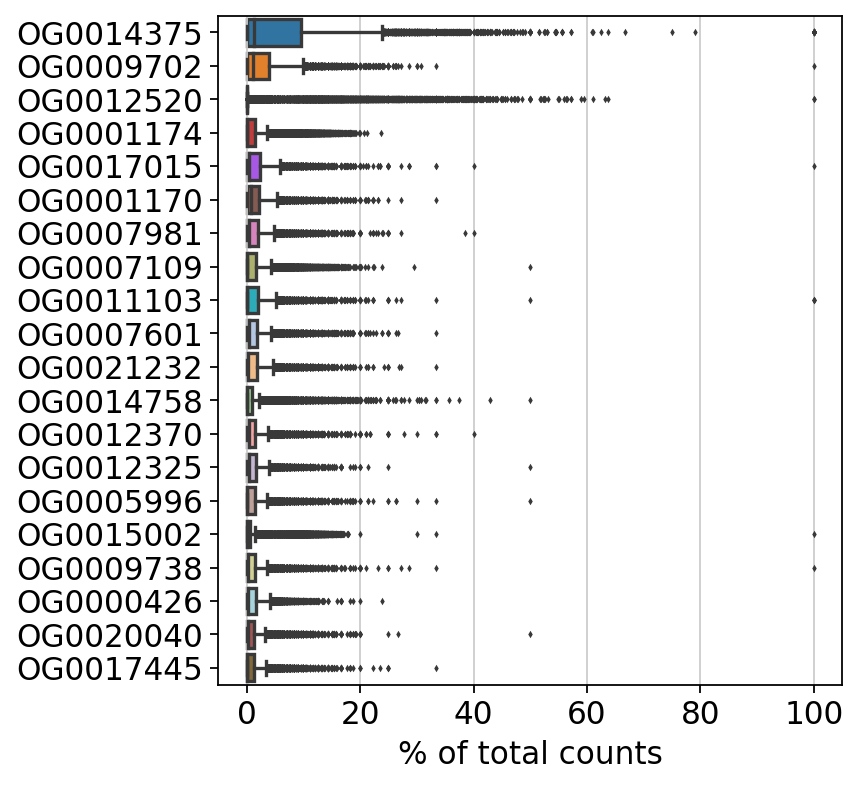

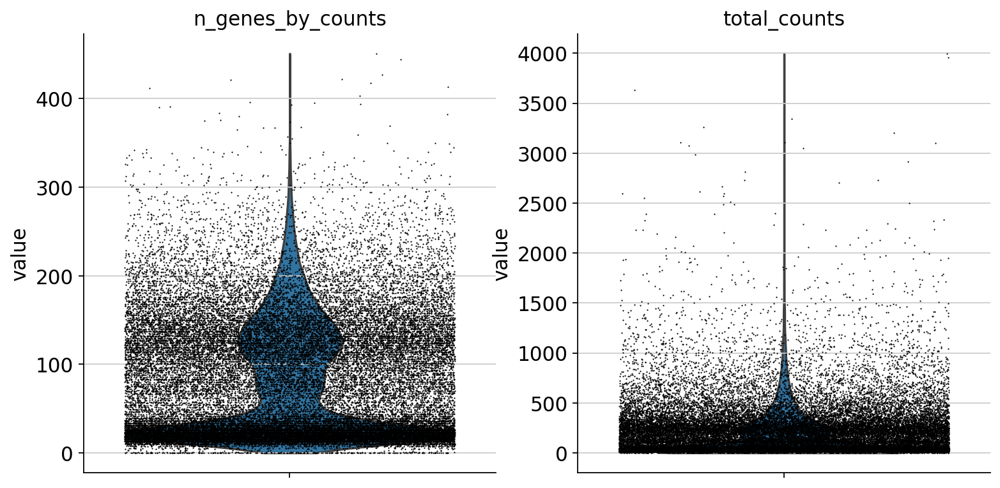

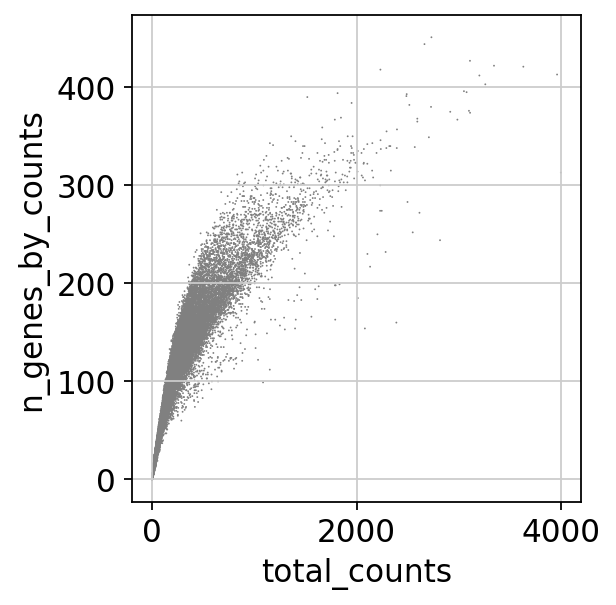

filtered out 20301 cells that have less than 50 genes expressed
normalizing counts per cell
    finished (0:00:00)


/home/ec2-user/miniconda3/envs/glial_origins/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


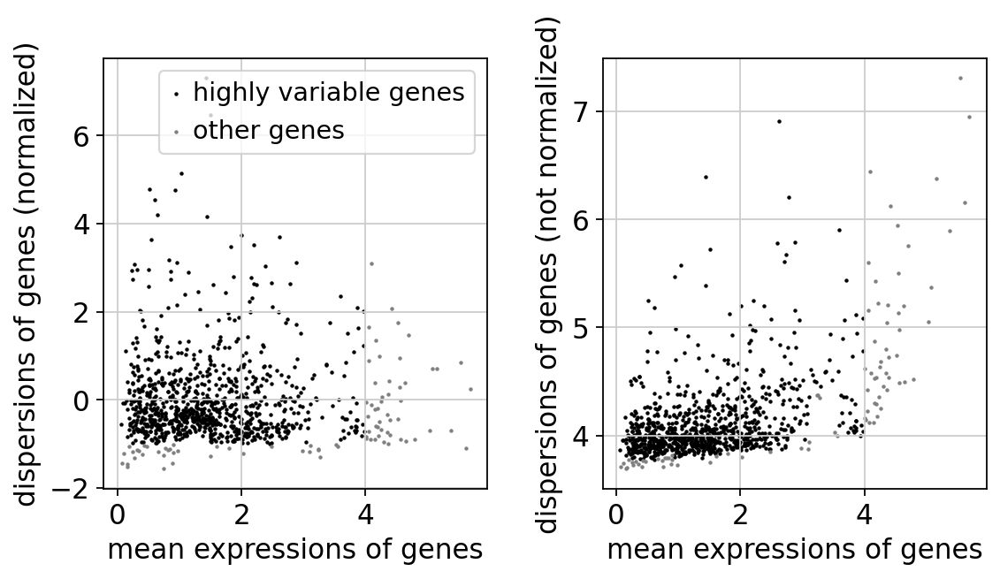

regressing out ['total_counts']
    finished (0:00:17)


In [7]:
sc.pl.highest_expr_genes(scanpy_data.adata, n_top=20, )
scanpy_data.violin()
scanpy_data.cellgene_filter(min_genes=50, min_cells=20)
scanpy_data.normalize(max_n_genes_by_counts = 7000, target_sum = 1e4)
scanpy_data.variable_filter(min_mean = 0.0125, max_mean = 4, min_disp = -1.0, max_disp = 10)
scanpy_data.regress_scale(how = ['total_counts'], max_value = 10)

In [8]:
scanpy_data.map_cellannots_multispecies(sample_MSD)

# 5A. Run PCA and UMAP/Leiden on gxc data

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


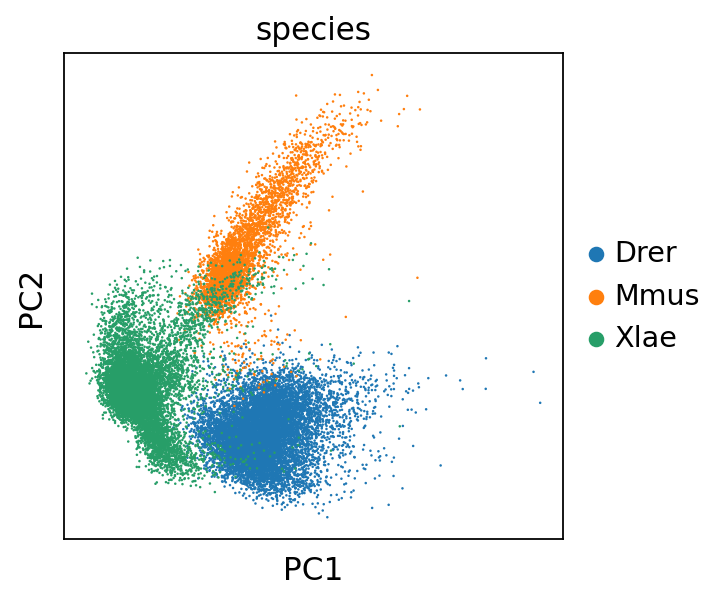

2022-11-29 22:43:50,827 - harmonypy - INFO - Iteration 1 of 10
2022-11-29 22:44:03,111 - harmonypy - INFO - Iteration 2 of 10
2022-11-29 22:44:15,241 - harmonypy - INFO - Converged after 2 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:28)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:44)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:14)


In [9]:
scanpy_data.pca_basic(color = ['species'])
sc.external.pp.harmony_integrate(scanpy_data.adata, 'species')

sc.pp.neighbors(scanpy_data.adata, n_neighbors=50, n_pcs = 40, use_rep = 'X_pca_harmony')
sc.tl.umap(scanpy_data.adata)
sc.tl.leiden(scanpy_data.adata)

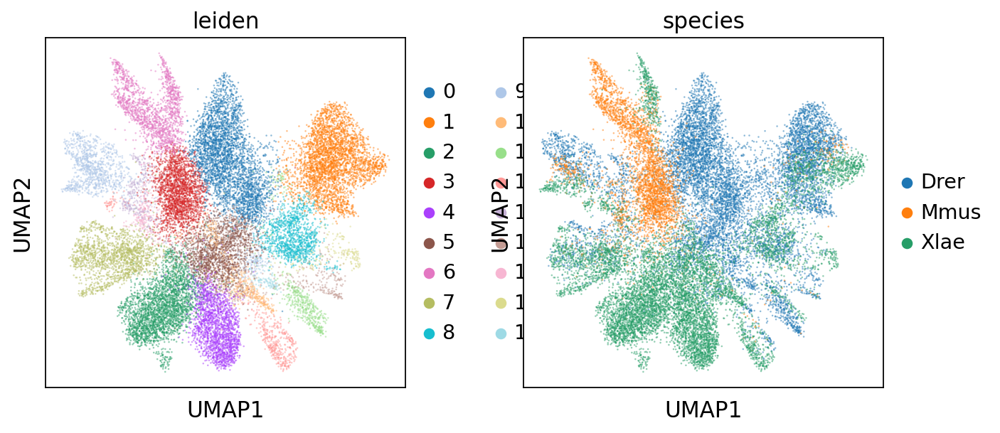

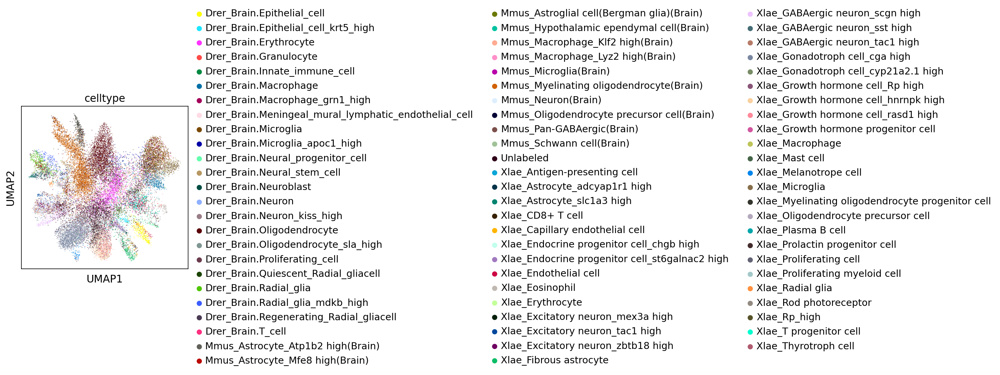

In [10]:
sc.pl.umap(scanpy_data.adata, alpha = 0.5, color = ['leiden', 'species'], save = 'DrerMmusXlae_clusters.pdf')
sc.pl.umap(scanpy_data.adata, alpha = 0.5, color = ['celltype'], save = 'DrerMmusXlae_celltypes.pdf')

# 6A. Plot expression of glial markers in gxc data

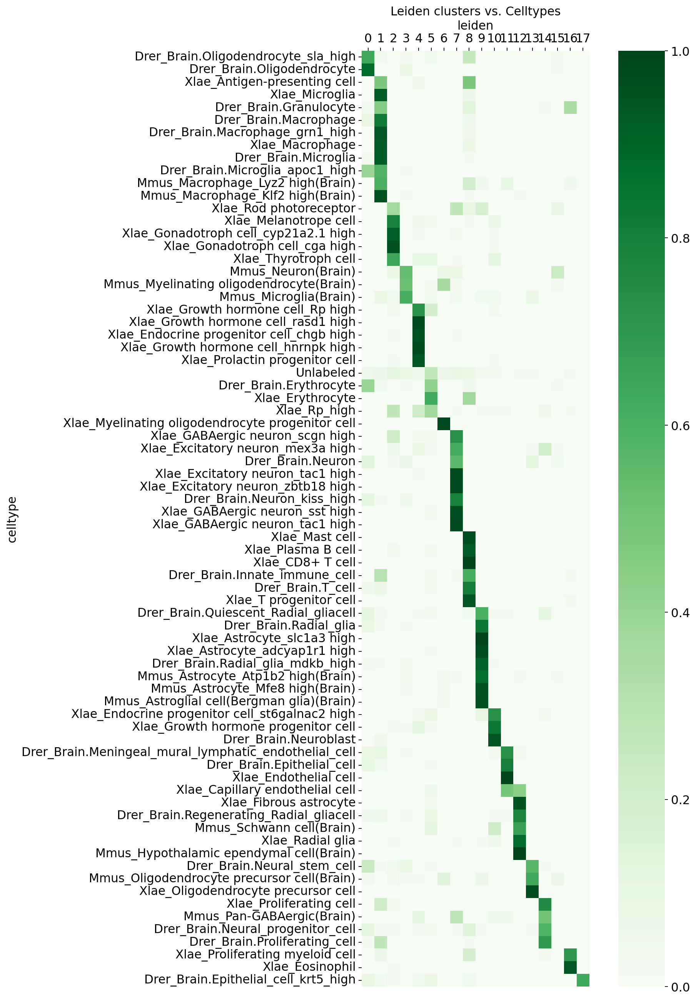

In [11]:
ctmx = sc.metrics.confusion_matrix("celltype", "leiden", scanpy_data.adata.obs)
ctmx_diag = diagonalize_df(ctmx)

plt.figure(figsize = (12, 20))
sns.heatmap(ctmx_diag, square = True, cmap = 'Greens')
plt.gca().xaxis.tick_top()
plt.gca().xaxis.set_label_position('top')
plt.title('Leiden clusters vs. Celltypes')
plt.savefig('DrerMmusXlae_clusters_vs_celltypes.pdf')

# 7A. Get top marker genes and plot them

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


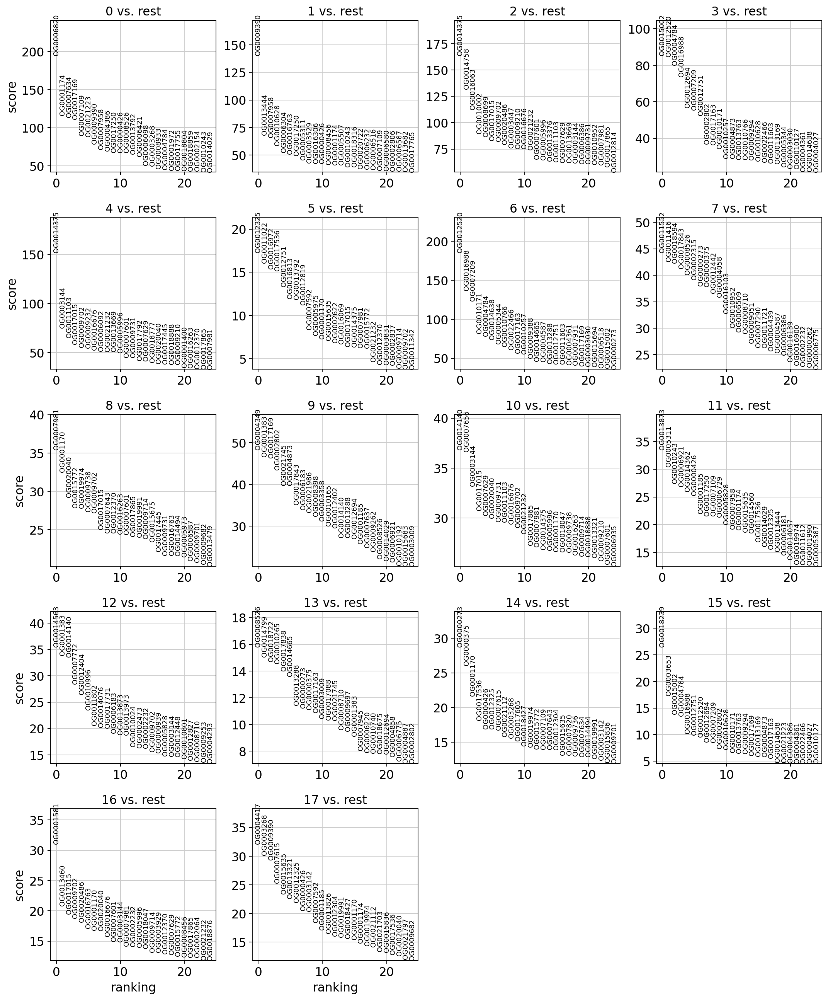

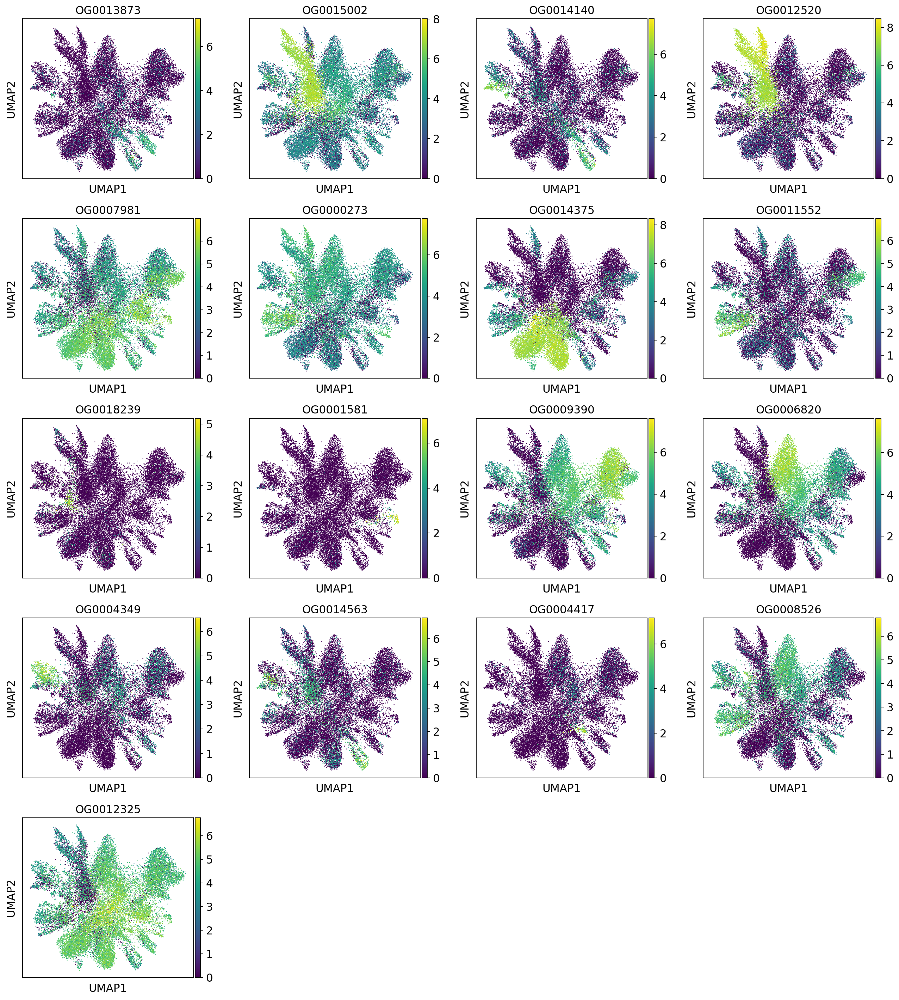

In [12]:
scanpy_data.rank_genes()
top_key, marker_key = scanpy_data.get_top_genes('gene-name')

# Running the line below exports top genes to file
#scanpy_data.export_top_genes(top_key)

sc.pl.umap(scanpy_data.adata, color=getattr(scanpy_data, marker_key))

# 8A. Cluster-specific genes

You can plot the `top_n` genes from a given `cluster_num` here for exploratory purposes.

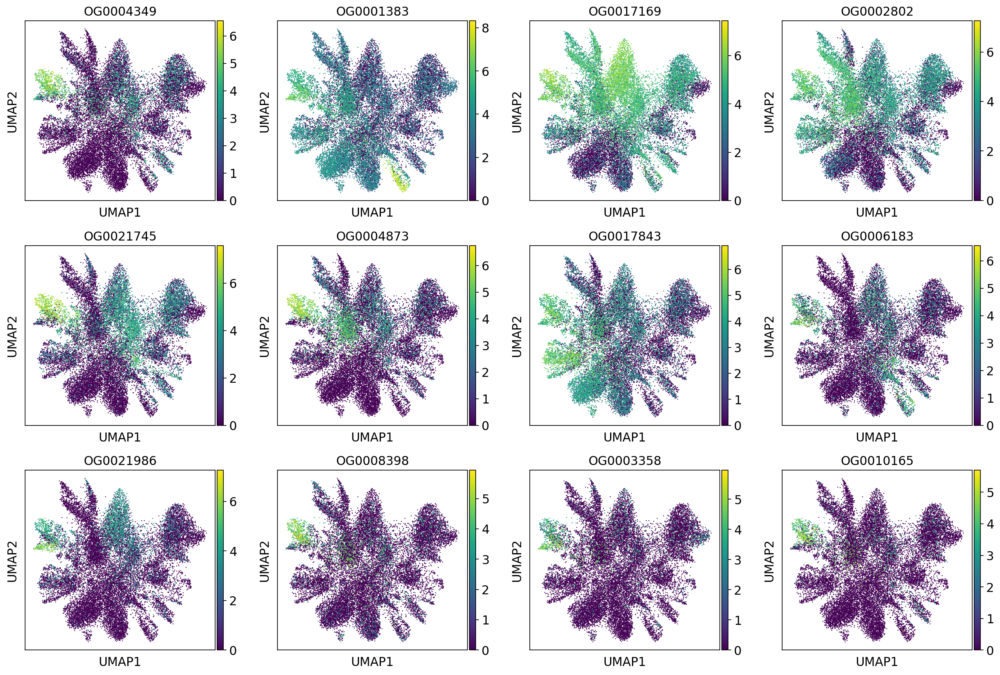

In [13]:
cluster_num = 9
top_n = 12

top_genelist = scanpy_data.marker_genes_df[str(cluster_num)].tolist()[0:top_n]

sc.pl.umap(scanpy_data.adata, color=top_genelist)

In [17]:
glial_og_dict = {}

# Retrieve idmm object from BioFileDocket
for pre in sample_MSD.species_BioFileDockets:
    idmm_object = sample_MSD.species_BioFileDockets[pre].og_idmm

    # Map gene names to orthogroup IDs
    glial_og_dict[pre] = scanpy_data.map_gene_to_id(idmm_object, top_genelist, 'Orthogroup', 'gene_name', check_ids = False)

,Orthogroup,gene_name
62,OG0001383,atp1a1a.4
63,OG0001383,atp1a1a.1
64,OG0001383,atp1a1a.3
2634,OG0017169,glula
3656,OG0001383,atp1a2a
10354,OG0002802,ckma
10761,OG0003358,slc4a4a
12415,OG0017169,glulb
14983,OG0006183,mdka
15184,OG0008398,mfge8a


,Orthogroup,gene_name
4611,OG0017169,Glul
5446,OG0001383,Atp1a2
6346,OG0021986,Acbd7
10200,OG0006183,Mdk
10500,OG0004873,Slc1a2
17275,OG0001383,Atp1a1
17789,OG0010165,S1pr1
27744,OG0003358,Slc4a4
37875,OG0002802,Ckm
38226,OG0001383,Atp1a3


,Orthogroup,gene_name
5459,OG0003358,slc4a4.L
9078,OG0003358,slc4a4.S
10770,OG0001383,atp1a1.L
11277,OG0017843,aldoc.L
14134,OG0001383,atp1a1.S
18042,OG0008398,mfge8.L
20225,OG0008398,mfge8.S
21630,OG0004873,slc1a2.L
21666,OG0006183,mdk.L
23064,OG0017169,glul-like.1.L


# 3B. Load exc matrix into scanpy

In [15]:
species_scanpy_data = {}

for pre in sample_MSD.species_BioFileDockets:
    scanpy_data = ScanpyMetaObject(
        matrix = sample_MSD.species_BioFileDockets[pre].gxc,
        sampledict = sample_MSD.species_BioFileDockets[pre].sampledict
    )
    species_scanpy_data[pre] = scanpy_data
    species_scanpy_data[pre].read()

... reading from cache file cache/..-..-output-Drer_adultbrain-GSM3768152_Brain_8_dge.h5ad
... reading from cache file cache/..-..-output-Mmus_adultbrain-GSM2906405_Brain1_dge_coerced.h5ad
... reading from cache file cache/..-..-output-Xlae_adultbrain-GSM6214268_Xenopus_brain_COL65_dge.h5ad


# 4B. Run basic filtering and regressions on gxc data
Each function call collapses several scanpy native functions into a single function.  
See the `utils/scanpy_wrapper.py` document for more details about the specific subfunctions.

In [16]:
for pre in species_scanpy_data:
    species_scanpy_data[pre].violin(plot = False)
    species_scanpy_data[pre].cellgene_filter(min_genes=100, min_cells=20)
    species_scanpy_data[pre].normalize(max_n_genes_by_counts = 7000, target_sum = 1e4)
    species_scanpy_data[pre].variable_filter(min_mean = 0.0125, max_mean = 3, min_disp = -0.5, max_disp = 10, plot = False)
    species_scanpy_data[pre].regress_scale(how = ['total_counts'], max_value = 10)
    
    species_scanpy_data[pre].map_cellannots(sample_MSD.species_BioFileDockets[pre].cellannot)
    species_scanpy_data[pre].pca_basic(plot = False)
    species_scanpy_data[pre].umap_leiden(plot = False)

filtered out 2 cells that have less than 100 genes expressed
filtered out 8708 genes that are detected in less than 20 cells


/home/ec2-user/miniconda3/envs/glial_origins/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts']
    finished (0:01:59)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:07)
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:40)
running Leiden clustering
    finished: found 23 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)
filtered out 9245 genes that are detected in less than 20 cells
normalizing counts per cell
    finished (0:0

/home/ec2-user/miniconda3/envs/glial_origins/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts']
    finished (0:00:30)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
filtered out 12800 cells that have less than 100 genes expressed
filtered out 7127 genes that are detected in less than 20 cells


/home/ec2-user/miniconda3/envs/glial_origins/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts']
    finished (0:03:42)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:11)
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:30)
running Leiden clustering
    finished: found 27 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:06)


# 5B. Run PCA and UMAP/Leiden on exc data

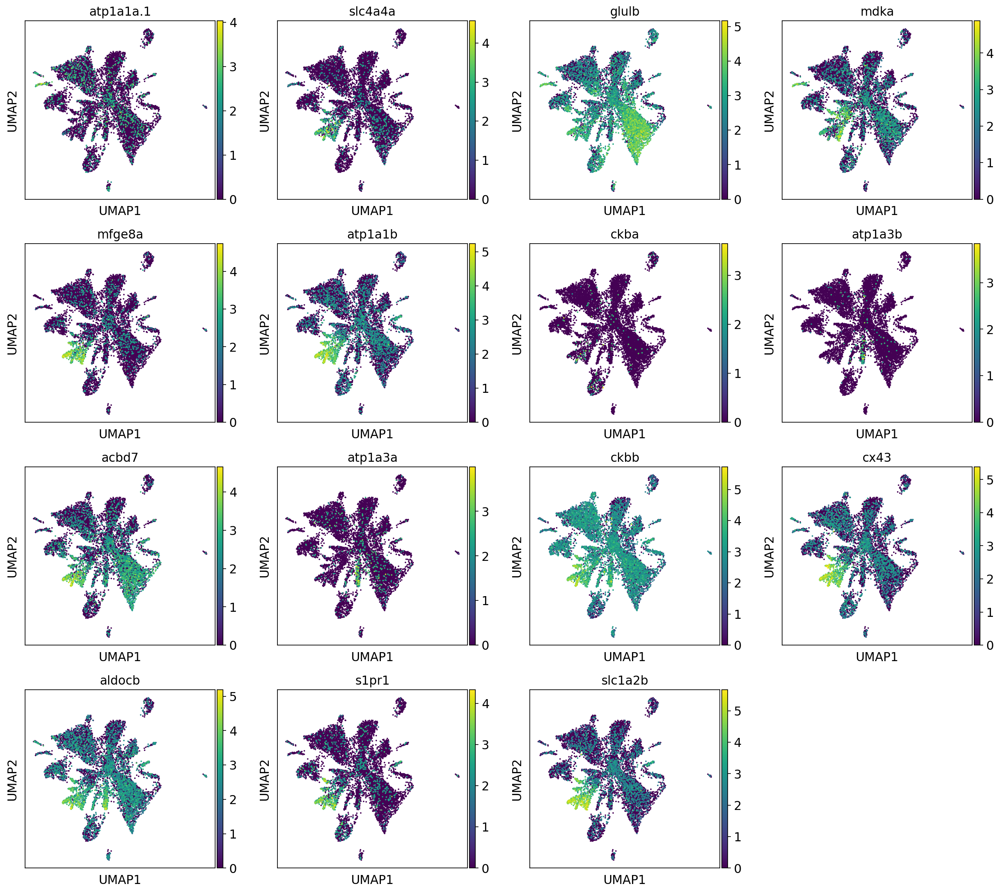

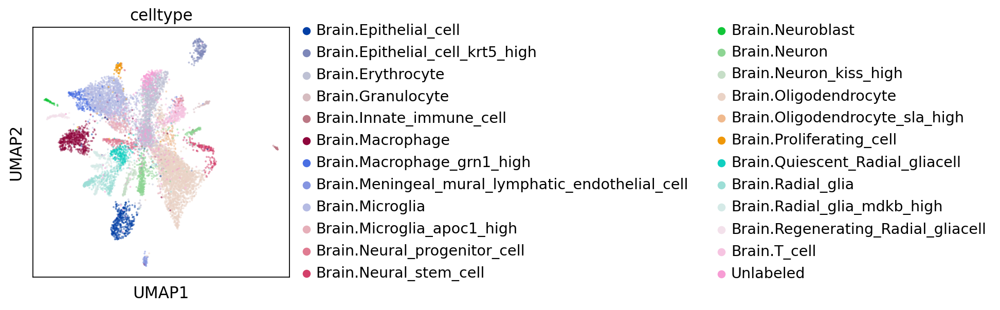

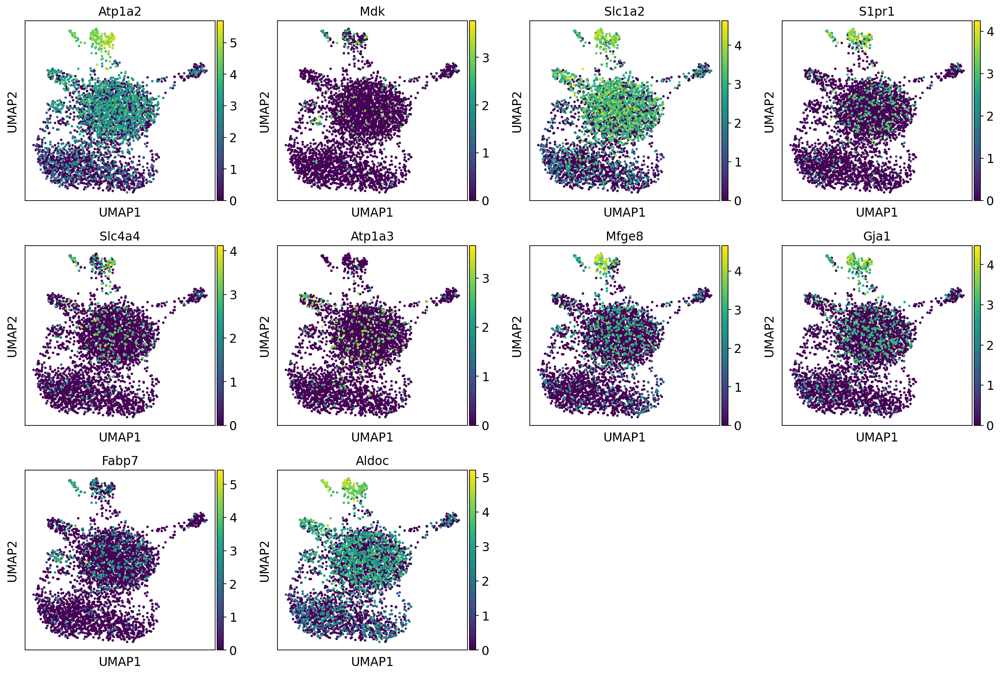

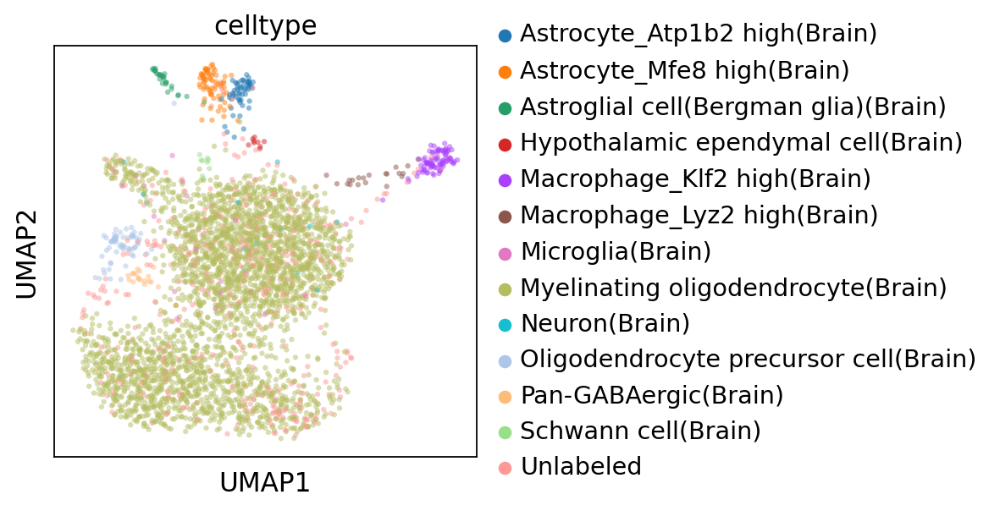

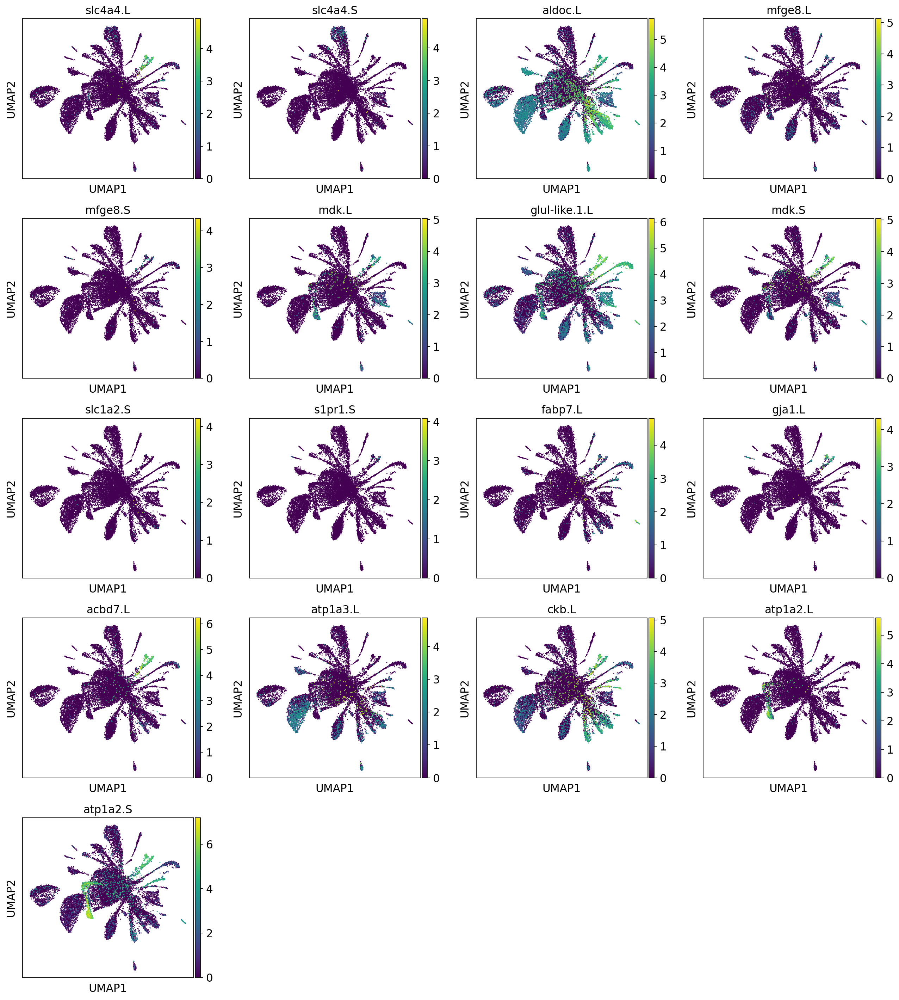

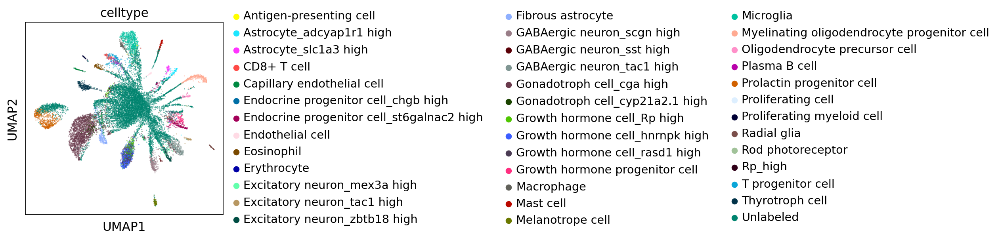

In [21]:
for pre in sample_MSD.species_BioFileDockets:
    glial_genes = glial_og_dict[pre]

    # Plot cells by orthogroups
    sc.pl.umap(species_scanpy_data[pre].adata, color=[i for i in glial_genes if i in species_scanpy_data[pre].adata.var.index])

    # Also plot celltype from cell annotation
    sc.pl.umap(species_scanpy_data[pre].adata, color='celltype', alpha = 0.5)

# 6B. Map, then plot expression of glial markers in exc data

,gene_name,Orthogroup
2634,glula,OG0017169
4236,sox10,OG0014665
5423,gfap,OG0011271
17197,aplnra,OG0004819
18761,olig1,OG0011699
43513,myrf,OG0023968
44675,slc1a2b,OG0004873


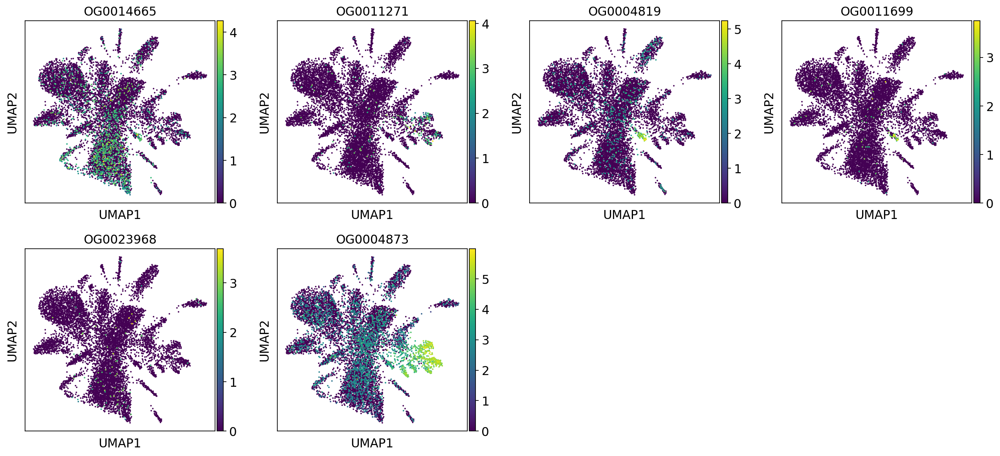

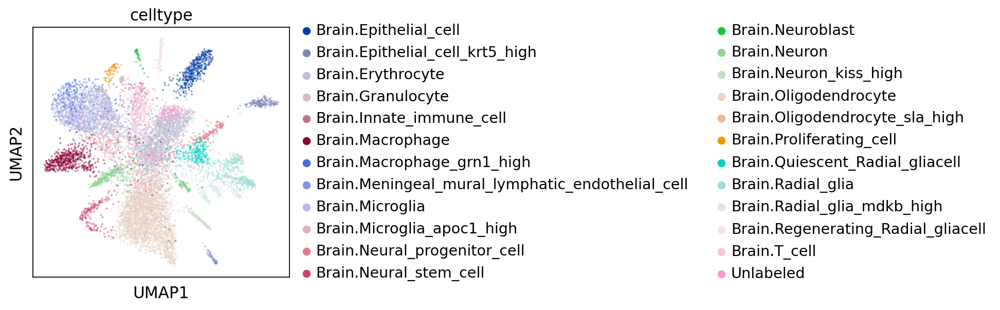

In [17]:
# Retrieve idmm object from BioFileDocket
idmm_object = species_BioFileDocket.og_idmm

# Map gene names to orthogroup IDs
glial_og = orthogroup_data.map_gene_to_id(idmm_object, glial_markers, 'gene_name', 'Orthogroup')

# Plot cells by orthogroups
sc.pl.umap(orthogroup_data.adata, color=glial_og)

# Also plot celltype from cell annotation
sc.pl.umap(orthogroup_data.adata, color='celltype', alpha = 0.5)

Text(0.5, 1.0, 'Leiden clusters vs. Celltypes')

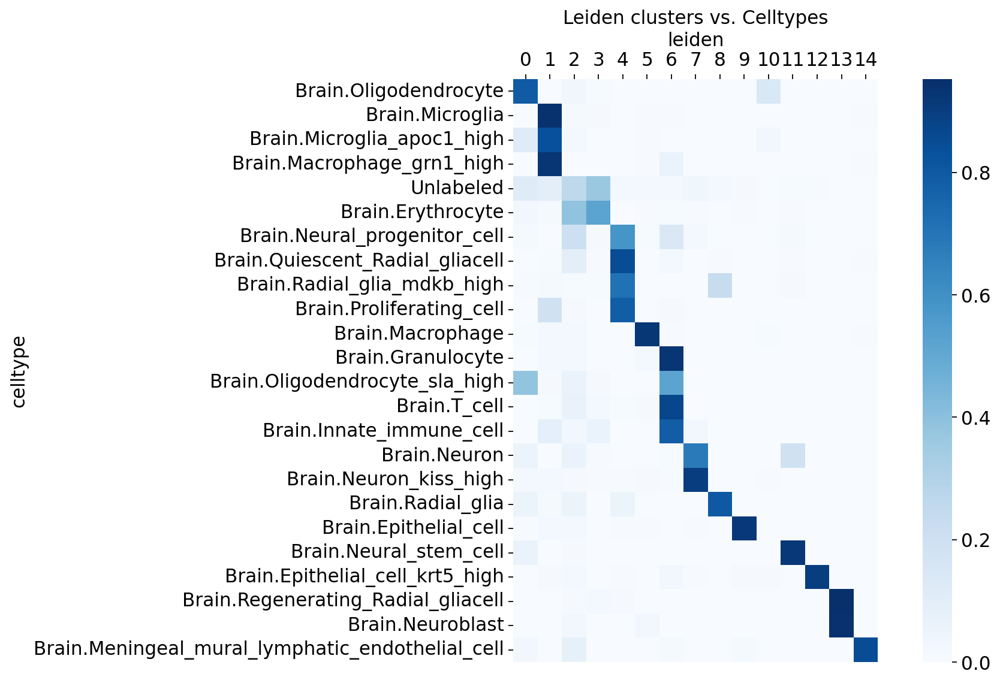

In [16]:
ctmx = sc.metrics.confusion_matrix("celltype", "leiden", orthogroup_data.adata.obs)
ctmx_diag = diagonalize_df(ctmx)

plt.figure(figsize = (12, 8))
sns.heatmap(ctmx_diag, square = True, cmap = 'Blues')
plt.gca().xaxis.tick_top()
plt.gca().xaxis.set_label_position('top') 
plt.title('Leiden clusters vs. Celltypes')

# 7B. Get top marker orthogroups and plot them

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


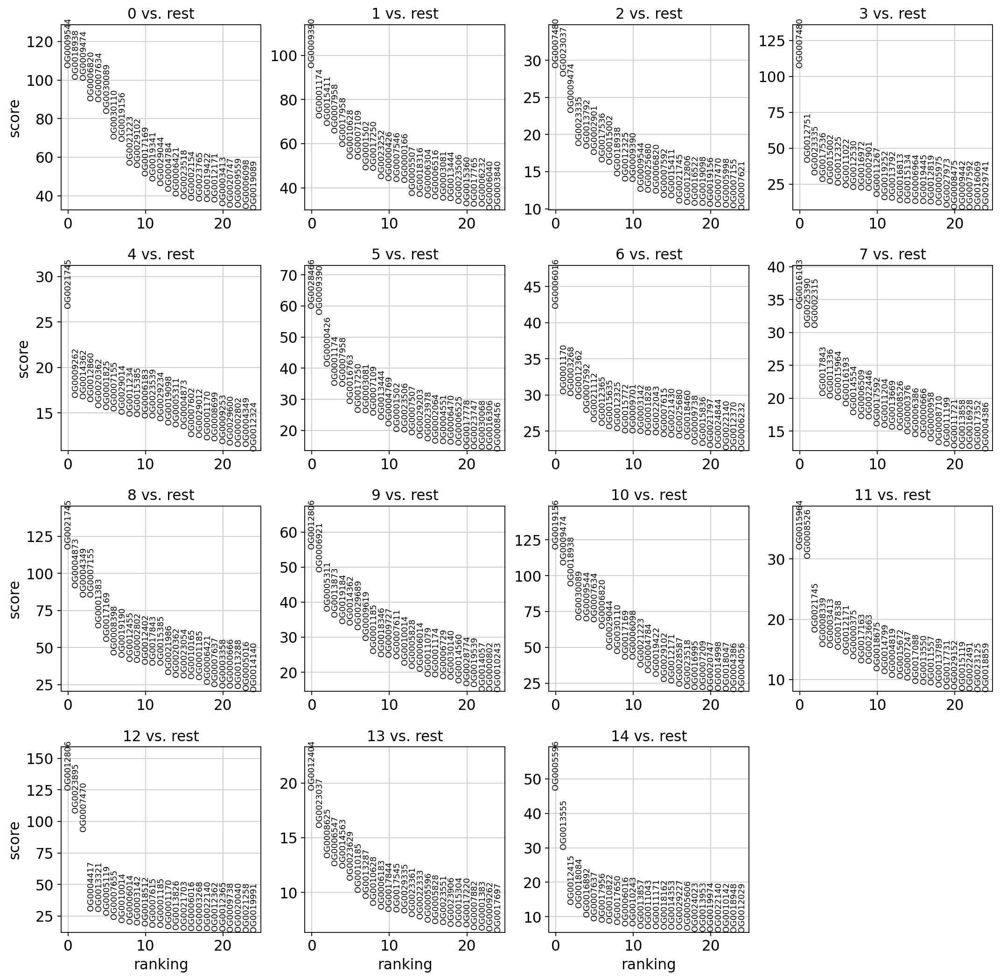

Wrote 1867 gene ids to ../../output/Drer_adultbrain/Drer_Exc_top_200DE_Orthogroup_ids.txt


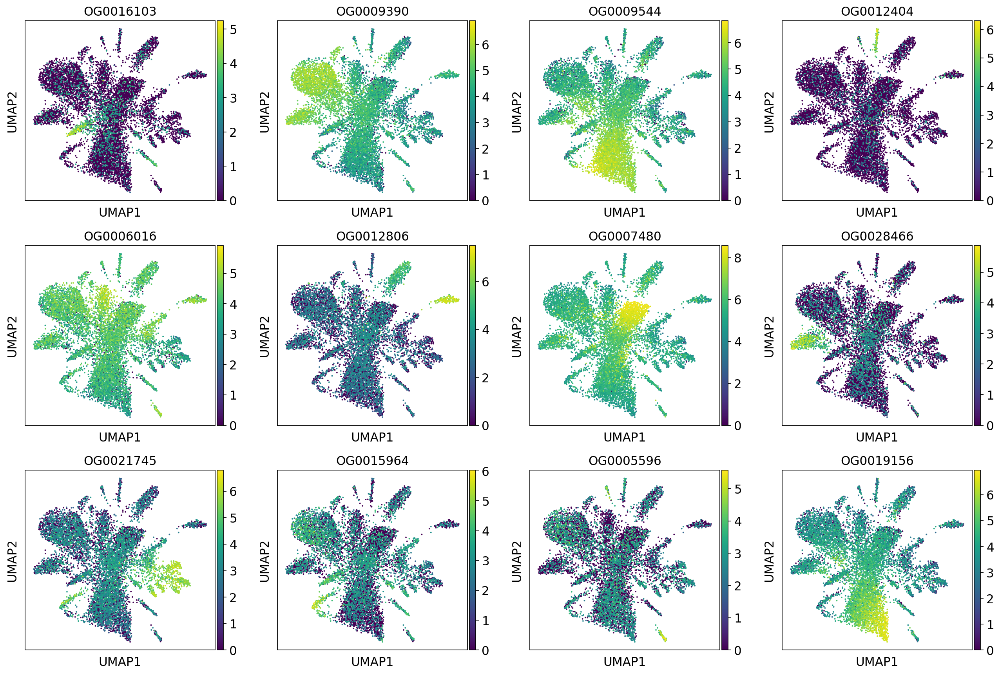

In [17]:
orthogroup_data.rank_genes()
top_orthogroup_key, marker_orthogroup_key = orthogroup_data.get_top_genes('Orthogroup')
orthogroup_data.export_top_genes(top_orthogroup_key)

sc.pl.umap(orthogroup_data.adata, color=getattr(orthogroup_data, marker_orthogroup_key))

In [18]:
top_orthogroup_filekey = top_orthogroup_key + '_file'

species_BioFileDocket.add_keyfile(getattr(orthogroup_data, top_orthogroup_filekey), 'topOrthogroups')
species_BioFileDocket.local_to_s3()
species_BioFileDocket.pickle()
species_BioFileDocket.push_to_s3(overwrite = False)

GCF_000002035.5_GRCz10_genomic.gff already exists in S3 bucket, skipping upload. set overwrite = True to overwrite the existing file.
GCF_000002035.5_GRCz10_genomic.fna already exists in S3 bucket, skipping upload. set overwrite = True to overwrite the existing file.
GSM3768152_Brain_8_dge.txt already exists in S3 bucket, skipping upload. set overwrite = True to overwrite the existing file.
Drer_adultbrain_uniprot-idmm.tsv already exists in S3 bucket, skipping upload. set overwrite = True to overwrite the existing file.
Drer_adultbrain_gtf-idmm.tsv already exists in S3 bucket, skipping upload. set overwrite = True to overwrite the existing file.
GCF_000002035.5_GRCz10_genomic_cDNA.fna already exists in S3 bucket, skipping upload. set overwrite = True to overwrite the existing file.
GCF_000002035.5_GRCz10_genomic_cDNA.fna.transdecoder.bed already exists in S3 bucket, skipping upload. set overwrite = True to overwrite the existing file.
GCF_000002035.5_GRCz10_genomic_cDNA.fna.transdecode

In [18]:
gxc_clusters = scanpy_data.adata.obs.copy(deep = True)
gxc_clusters['leiden'] = 'GeneClust_' + gxc_clusters['leiden'].astype('str')
gxc_clusters.rename(columns = {'leiden': 'leiden_genes'}, inplace = True)
gxc_clusters['cell_barcode'] = gxc_clusters.index
gxc_clusters = gxc_clusters[['cell_barcode', 'leiden_genes']].reset_index(drop = True)
display(gxc_clusters)

exc_clusters = orthogroup_data.adata.obs.copy(deep = True)
exc_clusters['leiden'] = 'OrthogroupClust_' + exc_clusters['leiden'].astype('str')
exc_clusters.rename(columns = {'leiden': 'leiden_orthogroups'}, inplace = True)
exc_clusters['cell_barcode'] = exc_clusters.index
exc_clusters = exc_clusters[['cell_barcode', 'leiden_orthogroups']].reset_index(drop = True)
display(exc_clusters)

merged_table = gxc_clusters.merge(exc_clusters, on = 'cell_barcode')
display(merged_table)

,cell_barcode,leiden_genes
0,ACAATATATTGTACCTGA,GeneClust_2
1,ACGTTGATGGCGTAGAGA,GeneClust_13
2,AACCTAACCTGAATTTGC,GeneClust_8
3,CTCGCAGCCCTCTATGTA,GeneClust_8
4,ACGTTGCGTATTTAGTCG,GeneClust_17
...,...,...
9993,AACCTATGGATGGGGTTT,GeneClust_3
9994,AAGCGGAGGACTCTCCAT,GeneClust_3
9995,ACCTGACTCGCAAGCGAG,GeneClust_3
9996,ACGTTGCAAAGTTTCATA,GeneClust_1


,cell_barcode,leiden_orthogroups
0,ACAATATATTGTACCTGA,OrthogroupClust_6
1,ACGTTGATGGCGTAGAGA,OrthogroupClust_12
2,AACCTAACCTGAATTTGC,OrthogroupClust_3
3,CTCGCAGCCCTCTATGTA,OrthogroupClust_3
4,ACGTTGCGTATTTAGTCG,OrthogroupClust_13
...,...,...
9979,AACCTATGGATGGGGTTT,OrthogroupClust_2
9980,AAGCGGAGGACTCTCCAT,OrthogroupClust_3
9981,ACCTGACTCGCAAGCGAG,OrthogroupClust_2
9982,ACGTTGCAAAGTTTCATA,OrthogroupClust_1


,cell_barcode,leiden_genes,leiden_orthogroups
0,ACAATATATTGTACCTGA,GeneClust_2,OrthogroupClust_6
1,ACGTTGATGGCGTAGAGA,GeneClust_13,OrthogroupClust_12
2,AACCTAACCTGAATTTGC,GeneClust_8,OrthogroupClust_3
3,CTCGCAGCCCTCTATGTA,GeneClust_8,OrthogroupClust_3
4,ACGTTGCGTATTTAGTCG,GeneClust_17,OrthogroupClust_13
...,...,...,...
9979,AACCTATGGATGGGGTTT,GeneClust_3,OrthogroupClust_2
9980,AAGCGGAGGACTCTCCAT,GeneClust_3,OrthogroupClust_3
9981,ACCTGACTCGCAAGCGAG,GeneClust_3,OrthogroupClust_2
9982,ACGTTGCAAAGTTTCATA,GeneClust_1,OrthogroupClust_1


In [42]:
import plotly.graph_objects as go
import numpy as np

items = sorted(list(merged_table['leiden_genes'].unique())) + sorted(list(merged_table['leiden_orthogroups'].unique()))
items_dict = {items[i]: i for i in np.arange(0, len(items))}

source = []
target = []
value = []
color = []

for i in merged_table['leiden_genes'].unique():
    subtable = merged_table[merged_table['leiden_genes'] == i]
    values = pd.DataFrame(subtable['leiden_orthogroups'].value_counts())
    source = source + [items_dict[i] for j in np.arange(0, len(values))]
    target = target + [items_dict[k] for k in list(values.index.values)]
    value = value + list(values['leiden_orthogroups'].values)
    color = color + ['rgba(247,184,70, 0.8)' if i == max(values['leiden_orthogroups'].values) else 'rgba(245,228,190, 0.5)' for i in values['leiden_orthogroups'].values]

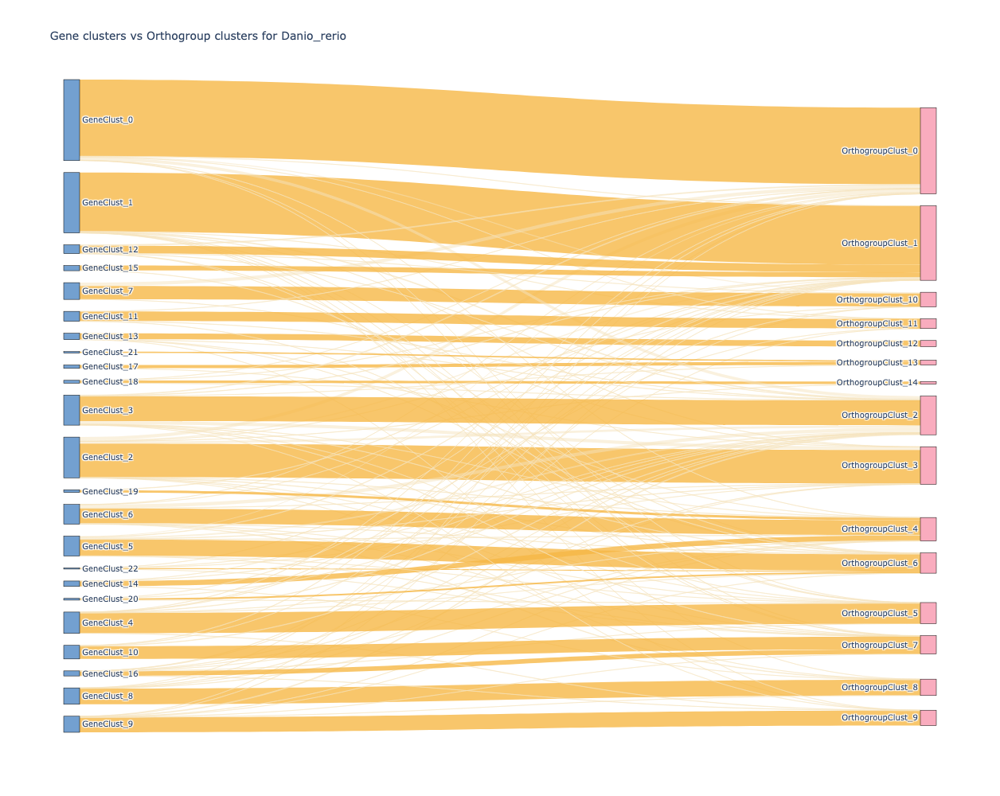

In [43]:
fig = go.Figure(data=[go.Sankey(
    node = dict(
      pad = 15,
      thickness = 20,
      line = dict(color = "black", width = 0.5),
      label = list(items_dict.keys()),
      color = ['rgba(248, 152, 174, 0.8)' if 'Orthogroup' in i else 'rgba(80, 137, 197, 0.8)' for i in list(items_dict.keys()) ]
    ),
    link = dict(
      source = source,
      target = target,
      value = value,
      color = color
  ))])

fig.update_layout(title_text="Gene clusters vs Orthogroup clusters for " + species_BioFileDocket.species, font_size=10, width=600, height=1000)
fig.show()